In [ ]:
import pickle

# Replace with your actual .pkl file path
file_path = './preprocessed_HEST_data/patch_to_expr_NCBI783.pkl'

# Load the pickle file
with open(file_path, 'rb') as f:
    data = pickle.load(f)

# Print the contents
print(data)

[{'patch_id': (22.0, 5.0), 'pil': <PIL.Image.Image image mode=RGB size=224x224 at 0x7FB934D12B90>, 'expr': array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0

In [5]:
len(data)

3869

In [2]:
import os
import torch
import pickle
import numpy as np
from tqdm import tqdm
import timm
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform
from timm.layers import SwiGLUPacked

In [19]:
# ---------------------
# CONFIGURATION
# ---------------------
pkl_folder = "./preprocessed_HEST_data/"           # Folder of .pkl files
output_dir = "./virchow_embeds"                        # Where to save per-file results
combined_embedding_path = "./virchow_embeds/all_patch_embeddings.npy"
combined_metadata_path = "./virchow_embeds/all_patch_metadata.npy"

os.makedirs(output_dir, exist_ok=True)

In [4]:
# ---------------------
# LOAD VIRCHOW2 MODEL
# ---------------------
model = timm.create_model(
    "hf-hub:paige-ai/Virchow2",
    pretrained=True,
    mlp_layer=SwiGLUPacked,
    act_layer=torch.nn.SiLU
)
model.eval()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

config.json:   0%|          | 0.00/742 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.53G [00:00<?, ?B/s]

VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 1280, kernel_size=(14, 14), stride=(14, 14))
    (norm): Identity()
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (patch_drop): Identity()
  (norm_pre): Identity()
  (blocks): Sequential(
    (0): Block(
      (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=1280, out_features=3840, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=1280, out_features=1280, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): LayerScale()
      (drop_path1): Identity()
      (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
      (mlp): GluMlp(
        (fc1): Linear(in_features=1280, out_features=6832, bias=True)
        (act): SiLU()
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity()
    

In [6]:
# ---------------------
# SETUP TRANSFORM
# ---------------------
transforms = create_transform(**resolve_data_config(model.pretrained_cfg, model=model))


In [20]:
# ---------------------
# LOOP THROUGH .PKL FILES (EACH IS A SAMPLE WITH MANY PATCHES)
# ---------------------

pkl_files = [f for f in os.listdir(pkl_folder) if f.endswith(".pkl")]
print(f"📂 Found {len(pkl_files)} .pkl files.")

all_embeddings = []
all_metadata = []

for pkl_file in tqdm(pkl_files, desc="Processing pkl files"):
    pkl_path = os.path.join(pkl_folder, pkl_file)

    try:
        with open(pkl_path, "rb") as f:
            patches = pickle.load(f)

        print(f"📦 {pkl_file} contains {len(patches)} patches")

        file_embeddings = []
        file_metadata = []

        for i, entry in enumerate(patches):
            try:
                pil_img = entry["pil"]
                expr_vec = entry["expr"]
                patch_id = entry["patch_id"]

                print(f"🔄 Processing patch {i+1}/{len(patches)} in {pkl_file}...")

                image_tensor = transforms(pil_img).unsqueeze(0).to(device)

                with torch.inference_mode(), torch.autocast(device_type=device.type, dtype=torch.float16):
                    output = model(image_tensor)
                    class_token = output[:, 0]
                    patch_tokens = output[:, 5:]
                    embedding = torch.cat([class_token, patch_tokens.mean(1)], dim=-1)
                    embedding = embedding.squeeze(0).to(torch.float16).cpu().numpy()

                file_embeddings.append(embedding)
                file_metadata.append((pkl_file, i, patch_id, expr_vec))

                all_embeddings.append(embedding)
                all_metadata.append((pkl_file, i, patch_id, expr_vec))

            except Exception as e:
                print(f"⚠️ Skipped patch {i} in {pkl_file}: {e}")

        print(f"✅ {len(file_embeddings)} / {len(patches)} patches embedded from {pkl_file}")

        # Save per-sample output
        base_name = os.path.splitext(pkl_file)[0]
        np.save(os.path.join(output_dir, f"{base_name}_embeddings.npy"), np.stack(file_embeddings))
        np.save(os.path.join(output_dir, f"{base_name}_metadata.npy"), np.array(file_metadata, dtype=object))

    except Exception as e:
        print(f"❌ Failed to process {pkl_file}: {e}")

📂 Found 36 .pkl files.


Processing pkl files:   0%|          | 0/36 [00:00<?, ?it/s]

📦 patch_to_expr_TENX133.pkl contains 3700 patches
🔄 Processing patch 1/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 2/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 3/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 4/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 5/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 6/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 7/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 8/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 9/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 10/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 11/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 12/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 13/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 14/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 15/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing patch 16/3700 in patch_to_expr_TENX133.pkl...
🔄 Processing pa

Processing pkl files:   3%|▎         | 1/36 [01:02<36:40, 62.86s/it]

🔄 Processing patch 3700/3700 in patch_to_expr_TENX133.pkl...
✅ 3700 / 3700 patches embedded from patch_to_expr_TENX133.pkl
📦 patch_to_expr_TENX158.pkl contains 2179 patches
🔄 Processing patch 1/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 2/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 3/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 4/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 5/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 6/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 7/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 8/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 9/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 10/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 11/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 12/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 13/2179 in patch_to_expr_TENX158.pkl...
🔄 Processing patch 14/2179 in patch_to_expr_TENX158.pkl...
🔄 Processi

Processing pkl files:   6%|▌         | 2/36 [01:40<27:12, 48.01s/it]

📦 patch_to_expr_TENX105.pkl contains 1628 patches
🔄 Processing patch 1/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 2/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 3/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 4/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 5/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 6/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 7/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 8/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 9/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 10/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 11/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 12/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 13/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 14/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 15/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 16/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing pa

Processing pkl files:   8%|▊         | 3/36 [02:08<21:19, 38.79s/it]

🔄 Processing patch 1621/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1622/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1623/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1624/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1625/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1626/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1627/1628 in patch_to_expr_TENX105.pkl...
🔄 Processing patch 1628/1628 in patch_to_expr_TENX105.pkl...
✅ 1628 / 1628 patches embedded from patch_to_expr_TENX105.pkl
📦 patch_to_expr_TENX97.pkl contains 11742 patches
🔄 Processing patch 1/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 2/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 3/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 4/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 5/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 6/11742 in patch_to_expr_TENX97.pkl...
🔄 Processing patch 7/11742 in patch_to_expr_TENX97.p

Processing pkl files:  11%|█         | 4/36 [05:33<55:44, 104.51s/it]

📦 patch_to_expr_TENX126.pkl contains 2190 patches
🔄 Processing patch 1/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 3/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 4/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 5/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 6/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 7/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 8/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 9/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 10/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 11/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 12/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 13/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 14/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 15/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 16/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing pa

Processing pkl files:  14%|█▍        | 5/36 [06:11<41:31, 80.38s/it] 

🔄 Processing patch 2185/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2186/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2187/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2188/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2189/2190 in patch_to_expr_TENX126.pkl...
🔄 Processing patch 2190/2190 in patch_to_expr_TENX126.pkl...
✅ 2190 / 2190 patches embedded from patch_to_expr_TENX126.pkl
📦 patch_to_expr_TENX142.pkl contains 3727 patches
🔄 Processing patch 1/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 2/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 4/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 5/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 6/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 7/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 8/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 9/3727 in patch_to_expr_TENX142.pkl...


Processing pkl files:  17%|█▋        | 6/36 [07:15<37:24, 74.82s/it]

🔄 Processing patch 3721/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3722/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3723/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3724/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3725/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3726/3727 in patch_to_expr_TENX142.pkl...
🔄 Processing patch 3727/3727 in patch_to_expr_TENX142.pkl...
✅ 3727 / 3727 patches embedded from patch_to_expr_TENX142.pkl
📦 patch_to_expr_TENX120.pkl contains 3690 patches
🔄 Processing patch 1/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 2/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 4/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 5/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 6/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 7/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 8/3690 in patch_to_expr_TENX120.pkl.

Processing pkl files:  19%|█▉        | 7/36 [08:18<34:19, 71.01s/it]

🔄 Processing patch 3685/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3686/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3687/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3688/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3689/3690 in patch_to_expr_TENX120.pkl...
🔄 Processing patch 3690/3690 in patch_to_expr_TENX120.pkl...
✅ 3690 / 3690 patches embedded from patch_to_expr_TENX120.pkl
📦 patch_to_expr_TENX134.pkl contains 3030 patches
🔄 Processing patch 1/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 2/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 4/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 5/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 6/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 7/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 8/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 9/3030 in patch_to_expr_TENX134.pkl...


Processing pkl files:  22%|██▏       | 8/36 [09:10<30:17, 64.90s/it]

🔄 Processing patch 3025/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3026/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3027/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3028/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3029/3030 in patch_to_expr_TENX134.pkl...
🔄 Processing patch 3030/3030 in patch_to_expr_TENX134.pkl...
✅ 3030 / 3030 patches embedded from patch_to_expr_TENX134.pkl
📦 patch_to_expr_TENX147.pkl contains 3997 patches
🔄 Processing patch 1/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 2/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 3/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 4/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 5/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 6/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 7/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 8/3997 in patch_to_expr_TENX147.pkl...
🔄 Processing patch 9/3997 in patch_to_expr_TENX147.pkl...


Processing pkl files:  25%|██▌       | 9/36 [10:18<29:43, 66.04s/it]

🔄 Processing patch 3997/3997 in patch_to_expr_TENX147.pkl...
✅ 3997 / 3997 patches embedded from patch_to_expr_TENX147.pkl
📦 patch_to_expr_TENX98.pkl contains 25724 patches
🔄 Processing patch 1/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 2/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 3/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 4/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 5/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 6/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 7/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 8/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 9/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 10/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 11/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 12/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 13/25724 in patch_to_expr_TENX98.pkl...
🔄 Processing patch 14/25724 in patch_to_expr_TENX98.pkl...
🔄 Processi

Processing pkl files:  28%|██▊       | 10/36 [18:07<1:22:28, 190.31s/it]

📦 patch_to_expr_TENX149.pkl contains 3974 patches
🔄 Processing patch 1/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 2/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 3/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 4/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 5/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 6/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 7/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 8/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 9/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 10/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 11/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 12/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 13/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 14/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 15/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 16/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing pa

Processing pkl files:  31%|███       | 11/36 [19:15<1:03:44, 153.00s/it]

🔄 Processing patch 3973/3974 in patch_to_expr_TENX149.pkl...
🔄 Processing patch 3974/3974 in patch_to_expr_TENX149.pkl...
✅ 3974 / 3974 patches embedded from patch_to_expr_TENX149.pkl
📦 patch_to_expr_NCBI783.pkl contains 3869 patches
🔄 Processing patch 1/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 2/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 3/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 4/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 5/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 6/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 7/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 8/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 9/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 10/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 11/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 12/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 13/3869 in patch_to_expr_NCBI783.pkl...
🔄 Proces

Processing pkl files:  33%|███▎      | 12/36 [20:22<50:40, 126.70s/it]  

🔄 Processing patch 3865/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 3866/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 3867/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 3868/3869 in patch_to_expr_NCBI783.pkl...
🔄 Processing patch 3869/3869 in patch_to_expr_NCBI783.pkl...
✅ 3869 / 3869 patches embedded from patch_to_expr_NCBI783.pkl
📦 patch_to_expr_TENX114.pkl contains 6006 patches
🔄 Processing patch 1/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 2/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 3/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 4/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 5/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 6/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 7/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 8/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 9/6006 in patch_to_expr_TENX114.pkl...
🔄 Processing patch 10/6006 in patch_to_expr_TENX114.pkl...
🔄 

Processing pkl files:  36%|███▌      | 13/36 [22:05<45:52, 119.66s/it]

📦 patch_to_expr_TENX96.pkl contains 7226 patches
🔄 Processing patch 1/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 2/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 3/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 4/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 5/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 6/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 7/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 8/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 9/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 10/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 11/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 12/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 13/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 14/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 15/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 16/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 17/7226 in pa

Processing pkl files:  39%|███▉      | 14/36 [24:10<44:25, 121.15s/it]

🔄 Processing patch 7225/7226 in patch_to_expr_TENX96.pkl...
🔄 Processing patch 7226/7226 in patch_to_expr_TENX96.pkl...
✅ 7226 / 7226 patches embedded from patch_to_expr_TENX96.pkl
📦 patch_to_expr_TENX123.pkl contains 10235 patches
🔄 Processing patch 1/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 2/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 3/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 4/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 5/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 6/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 7/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 8/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 9/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 10/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 11/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 12/10235 in patch_to_expr_TENX123.pkl...
🔄 Processing patch 13/10235 in patch_to_expr_TENX123.pkl.

Processing pkl files:  42%|████▏     | 15/36 [27:07<48:20, 138.13s/it]

📦 patch_to_expr_TENX94.pkl contains 9064 patches
🔄 Processing patch 1/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 2/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 3/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 4/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 5/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 6/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 7/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 8/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 9/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 10/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 11/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 12/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 13/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 14/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 15/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 16/9064 in patch_to_expr_TENX94.pkl...
🔄 Processing patch 17/9064 in pa

Processing pkl files:  44%|████▍     | 16/36 [29:46<48:07, 144.39s/it]

🔄 Processing patch 9064/9064 in patch_to_expr_TENX94.pkl...
✅ 9064 / 9064 patches embedded from patch_to_expr_TENX94.pkl
📦 patch_to_expr_TENX139.pkl contains 4137 patches
🔄 Processing patch 1/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 2/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 3/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 4/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 5/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 6/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 7/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 8/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 9/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 10/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 11/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 12/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 13/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing patch 14/4137 in patch_to_expr_TENX139.pkl...
🔄 Processing

Processing pkl files:  47%|████▋     | 17/36 [30:58<38:47, 122.49s/it]

📦 patch_to_expr_NCBI785.pkl contains 4180 patches
🔄 Processing patch 1/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 2/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 3/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 4/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 5/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 6/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 7/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 8/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 9/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 10/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 11/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 12/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 13/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 14/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 15/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 16/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing pa

Processing pkl files:  50%|█████     | 18/36 [32:10<32:14, 107.46s/it]

🔄 Processing patch 4177/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 4178/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 4179/4180 in patch_to_expr_NCBI785.pkl...
🔄 Processing patch 4180/4180 in patch_to_expr_NCBI785.pkl...
✅ 4180 / 4180 patches embedded from patch_to_expr_NCBI785.pkl
📦 patch_to_expr_NCBI784.pkl contains 3192 patches
🔄 Processing patch 1/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 2/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 3/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 4/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 5/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 6/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 7/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 8/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 9/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 10/3192 in patch_to_expr_NCBI784.pkl...
🔄 Processing patch 11/3192 in patch_to_expr_NCBI784.pkl...
🔄 Pr

Processing pkl files:  53%|█████▎    | 19/36 [33:06<26:01, 91.87s/it] 

✅ 3192 / 3192 patches embedded from patch_to_expr_NCBI784.pkl
📦 patch_to_expr_TENX111.pkl contains 6552 patches
🔄 Processing patch 1/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 2/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 3/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 4/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 5/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 6/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 7/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 8/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 9/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 10/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 11/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 12/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 13/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 14/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing patch 15/6552 in patch_to_expr_TENX111.pkl...
🔄 Processing

Processing pkl files:  56%|█████▌    | 20/36 [34:59<26:13, 98.35s/it]

✅ 6552 / 6552 patches embedded from patch_to_expr_TENX111.pkl
📦 patch_to_expr_TENX95.pkl contains 11628 patches
🔄 Processing patch 1/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 2/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 3/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 4/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 5/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 6/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 7/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 8/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 9/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 10/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 11/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 12/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 13/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 14/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing patch 15/11628 in patch_to_expr_TENX95.pkl...
🔄 Processing

Processing pkl files:  58%|█████▊    | 21/36 [38:21<32:21, 129.46s/it]

📦 patch_to_expr_TENX99.pkl contains 23017 patches
🔄 Processing patch 1/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 2/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 3/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 4/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 5/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 6/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 7/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 8/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 9/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 10/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 11/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 12/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 13/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 14/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 15/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing patch 16/23017 in patch_to_expr_TENX99.pkl...
🔄 Processing pa

Processing pkl files:  61%|██████    | 22/36 [45:20<50:27, 216.24s/it]

📦 patch_to_expr_TENX121.pkl contains 8664 patches
🔄 Processing patch 1/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 2/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 3/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 4/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 5/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 6/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 7/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 8/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 9/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 10/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 11/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 12/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 13/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 14/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 15/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing patch 16/8664 in patch_to_expr_TENX121.pkl...
🔄 Processing pa

Processing pkl files:  64%|██████▍   | 23/36 [47:51<42:37, 196.74s/it]

🔄 Processing patch 8664/8664 in patch_to_expr_TENX121.pkl...
✅ 8664 / 8664 patches embedded from patch_to_expr_TENX121.pkl
📦 patch_to_expr_TENX125.pkl contains 9576 patches
🔄 Processing patch 1/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 2/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 3/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 4/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 5/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 6/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 7/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 8/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 9/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 10/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 11/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 12/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 13/9576 in patch_to_expr_TENX125.pkl...
🔄 Processing patch 14/9576 in patch_to_expr_TENX125.pkl...
🔄 Processi

Processing pkl files:  67%|██████▋   | 24/36 [50:39<37:36, 188.03s/it]

🔄 Processing patch 9576/9576 in patch_to_expr_TENX125.pkl...
✅ 9576 / 9576 patches embedded from patch_to_expr_TENX125.pkl
📦 patch_to_expr_TENX140.pkl contains 4378 patches
🔄 Processing patch 1/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 2/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 3/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 4/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 5/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 6/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 7/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 8/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 9/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 10/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 11/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 12/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 13/4378 in patch_to_expr_TENX140.pkl...
🔄 Processing patch 14/4378 in patch_to_expr_TENX140.pkl...
🔄 Processi

Processing pkl files:  69%|██████▉   | 25/36 [51:55<28:20, 154.60s/it]

🔄 Processing patch 4378/4378 in patch_to_expr_TENX140.pkl...
✅ 4378 / 4378 patches embedded from patch_to_expr_TENX140.pkl
📦 patch_to_expr_TENX124.pkl contains 11718 patches
🔄 Processing patch 1/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 2/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 3/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 4/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 5/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 6/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 7/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 8/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 9/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 10/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 11/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 12/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 13/11718 in patch_to_expr_TENX124.pkl...
🔄 Processing patch 14/11718 in patch_to_expr_TENX124.pk

Processing pkl files:  72%|███████▏  | 26/36 [55:20<28:17, 169.72s/it]

✅ 11718 / 11718 patches embedded from patch_to_expr_TENX124.pkl
📦 patch_to_expr_TENX117.pkl contains 1682 patches
🔄 Processing patch 1/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 2/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 3/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 4/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 5/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 6/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 7/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 8/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 9/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 10/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 11/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 12/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 13/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 14/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 15/1682 in patch_to_expr_TENX117.pkl...
🔄 Processi

Processing pkl files:  75%|███████▌  | 27/36 [55:49<19:07, 127.51s/it]

🔄 Processing patch 1681/1682 in patch_to_expr_TENX117.pkl...
🔄 Processing patch 1682/1682 in patch_to_expr_TENX117.pkl...
✅ 1682 / 1682 patches embedded from patch_to_expr_TENX117.pkl
📦 patch_to_expr_TENX106.pkl contains 2610 patches
🔄 Processing patch 1/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 2/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 3/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 4/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 5/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 6/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 7/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 8/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 9/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 10/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 11/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 12/2610 in patch_to_expr_TENX106.pkl...
🔄 Processing patch 13/2610 in patch_to_expr_TENX106.pkl...
🔄 Proces

Processing pkl files:  78%|███████▊  | 28/36 [56:35<13:42, 102.84s/it]

📦 patch_to_expr_TENX157.pkl contains 4427 patches
🔄 Processing patch 1/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 2/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 3/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 4/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 5/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 6/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 7/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 8/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 9/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 10/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 11/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 12/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 13/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 14/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 15/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing patch 16/4427 in patch_to_expr_TENX157.pkl...
🔄 Processing pa

Processing pkl files:  81%|████████  | 29/36 [57:51<11:05, 95.02s/it] 

📦 patch_to_expr_TENX132.pkl contains 9306 patches
🔄 Processing patch 1/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 2/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 3/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 4/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 5/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 6/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 7/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 8/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 9/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 10/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 11/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 12/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 13/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 14/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 15/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing patch 16/9306 in patch_to_expr_TENX132.pkl...
🔄 Processing pa

Processing pkl files:  83%|████████▎ | 30/36 [1:00:33<11:30, 115.09s/it]

📦 patch_to_expr_TENX148.pkl contains 4317 patches
🔄 Processing patch 1/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 2/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 3/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 4/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 5/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 6/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 7/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 8/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 9/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 10/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 11/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 12/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 13/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 14/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 15/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing patch 16/4317 in patch_to_expr_TENX148.pkl...
🔄 Processing pa

Processing pkl files:  86%|████████▌ | 31/36 [1:01:48<08:34, 102.98s/it]

📦 patch_to_expr_TENX138.pkl contains 10456 patches
🔄 Processing patch 1/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 2/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 3/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 4/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 5/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 6/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 7/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 8/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 9/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 10/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 11/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 12/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 13/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 14/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 15/10456 in patch_to_expr_TENX138.pkl...
🔄 Processing patch 16/10456 in patch_to_expr_TENX138.pkl..

Processing pkl files:  89%|████████▉ | 32/36 [1:04:50<08:27, 126.79s/it]

📦 patch_to_expr_TENX122.pkl contains 4118 patches
🔄 Processing patch 1/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 2/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 3/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 4/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 5/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 6/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 7/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 8/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 9/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 10/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 11/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 12/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 13/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 14/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 15/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 16/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing pa

Processing pkl files:  92%|█████████▏| 33/36 [1:06:02<05:30, 110.13s/it]

🔄 Processing patch 4117/4118 in patch_to_expr_TENX122.pkl...
🔄 Processing patch 4118/4118 in patch_to_expr_TENX122.pkl...
✅ 4118 / 4118 patches embedded from patch_to_expr_TENX122.pkl
📦 patch_to_expr_TENX116.pkl contains 2646 patches
🔄 Processing patch 1/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 3/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 4/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 5/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 6/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 7/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 8/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 9/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 10/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 11/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 12/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 13/2646 in patch_to_expr_TENX116.pkl...
🔄 Proces

Processing pkl files:  94%|█████████▍| 34/36 [1:06:47<03:01, 90.81s/it] 

🔄 Processing patch 2641/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2642/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2643/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2644/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2645/2646 in patch_to_expr_TENX116.pkl...
🔄 Processing patch 2646/2646 in patch_to_expr_TENX116.pkl...
✅ 2646 / 2646 patches embedded from patch_to_expr_TENX116.pkl
📦 patch_to_expr_TENX119.pkl contains 1876 patches
🔄 Processing patch 1/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 2/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 3/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 4/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 5/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 6/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 7/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 8/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 9/1876 in patch_to_expr_TENX119.pkl...


Processing pkl files:  97%|█████████▋| 35/36 [1:07:20<01:13, 73.28s/it]

🔄 Processing patch 1873/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 1874/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 1875/1876 in patch_to_expr_TENX119.pkl...
🔄 Processing patch 1876/1876 in patch_to_expr_TENX119.pkl...
✅ 1876 / 1876 patches embedded from patch_to_expr_TENX119.pkl
📦 patch_to_expr_TENX115.pkl contains 3472 patches
🔄 Processing patch 1/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 2/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 3/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 4/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 5/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 6/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 7/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 8/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 9/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 10/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 11/3472 in patch_to_expr_TENX115.pkl...
🔄 Pr

Processing pkl files: 100%|██████████| 36/36 [1:08:20<00:00, 113.90s/it]

🔄 Processing patch 3469/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 3470/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 3471/3472 in patch_to_expr_TENX115.pkl...
🔄 Processing patch 3472/3472 in patch_to_expr_TENX115.pkl...
✅ 3472 / 3472 patches embedded from patch_to_expr_TENX115.pkl


In [21]:
if len(all_embeddings) > 0:
    np.save(combined_embedding_path, np.stack(all_embeddings))
    np.save(combined_metadata_path, np.array(all_metadata, dtype=object))
    print(f"\n✅ Saved {len(all_embeddings)} combined patch embeddings to: {combined_embedding_path}")
    print(f"✅ Saved combined metadata to: {combined_metadata_path}")
else:
    print("⚠️ No embeddings were successfully generated — check logs above.")

print(f"\n📂 Per-sample results saved in: {output_dir}")


✅ Saved 233933 combined patch embeddings to: ./virchow_embeds/all_patch_embeddings.npy
✅ Saved combined metadata to: ./virchow_embeds/all_patch_metadata.npy

📂 Per-sample results saved in: ./virchow_embeds


In [22]:
import numpy as np

E = np.load("virchow_embeds/patch_to_expr_NCBI783_embeddings.npy")
M = np.load("virchow_embeds/patch_to_expr_NCBI783_metadata.npy", allow_pickle=True)

print("Embeddings shape:", E.shape)      # (3869, 2560)
print("Metadata length:", len(M))        # 3869
print("Example entry:", M[0])


Embeddings shape: (3869, 2560)
Metadata length: 3869
Example entry: ['patch_to_expr_NCBI783.pkl' 0 (22.0, 5.0)
 array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0

In [13]:
#Test to see if .npy looks as expected with the virchow2 model

import numpy as np

embeddings = np.load("virchow_embeds/patch_to_expr_NCBI783_embeddings.npy")
print("Embedding shape:", embeddings.shape)  # Should be (3869, 2560)


Embedding shape: (3869, 2560)


/home/v-akthoutam/miniconda3/envs/squidp/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/v-akthoutam/miniconda3/envs/squidp/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


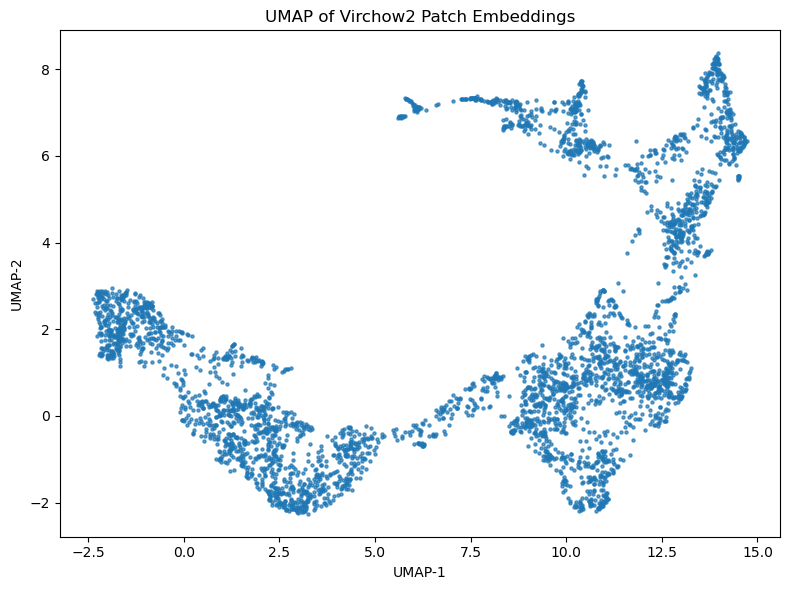

In [14]:
import umap
import matplotlib.pyplot as plt

# Reduce dimensions
reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, metric='cosine', random_state=42)
embedding_2d = reducer.fit_transform(embeddings)

# Plot
plt.figure(figsize=(8, 6))
plt.scatter(embedding_2d[:, 0], embedding_2d[:, 1], s=5, alpha=0.7)
plt.title("UMAP of Virchow2 Patch Embeddings")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.tight_layout()
plt.show()


Patch ID: (22.0, 5.0)


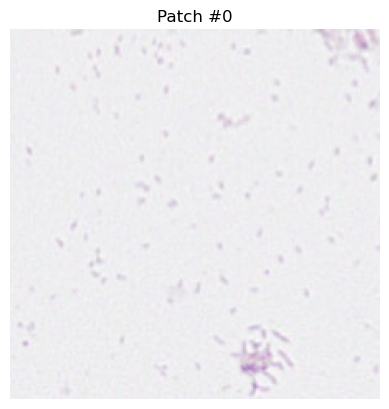

Patch ID: (23.0, 81.0)


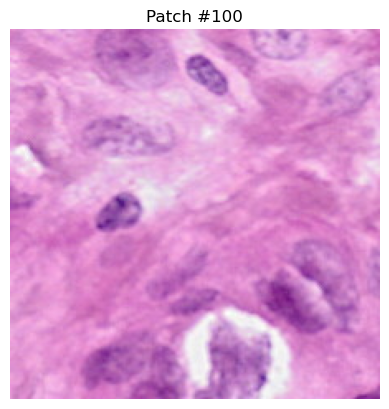

Patch ID: (37.0, 42.0)


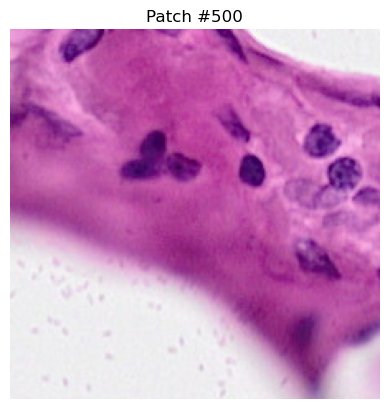

Patch ID: (51.0, 80.0)


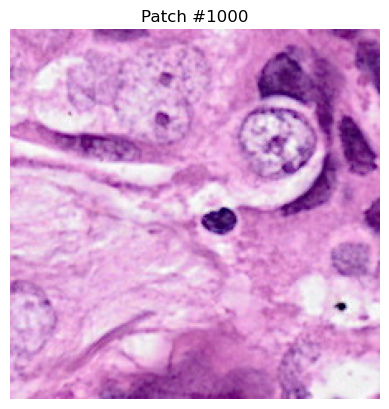

In [15]:
#Compare to the original embeddings

import matplotlib.pyplot as plt
import numpy as np
import pickle
from PIL import Image

# Load metadata
metadata = np.load("virchow_embeds/patch_to_expr_NCBI783_metadata.npy", allow_pickle=True)

# Load pkl again for images
with open("test_patch/patch_to_expr_NCBI783.pkl", "rb") as f:
    patches = pickle.load(f)

# Choose a few points in embedding space
for idx in [0, 100, 500, 1000]:
    print("Patch ID:", metadata[idx][2])  # (x, y)
    plt.imshow(patches[idx]["pil"])
    plt.title(f"Patch #{idx}")
    plt.axis("off")
    plt.show()


Closest patches to reference patch:


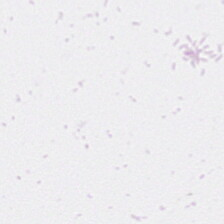

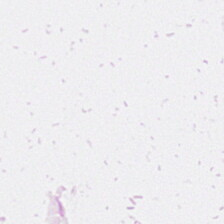

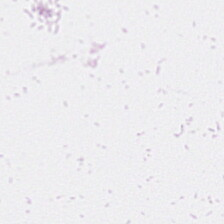

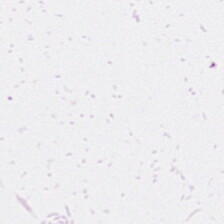

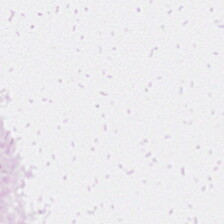

In [16]:
#Inspect similarity in embedding space

from sklearn.metrics.pairwise import cosine_distances

# Choose a reference patch
ref_idx = 0
ref_emb = embeddings[ref_idx:ref_idx+1]

# Find top 5 nearest neighbors
dists = cosine_distances(ref_emb, embeddings)[0]
nn_indices = np.argsort(dists)[1:6]

print("Closest patches to reference patch:")
for i in nn_indices:
    patches[i]["pil"].show()


In [17]:
# Sanity check Embedding norms - norms should be non-zero, likely around 20–60 depending on fp16 scaling and LayerNorm behavior.

import numpy as np

norms = np.linalg.norm(embeddings, axis=1)
print("Norm stats: mean =", norms.mean(), "min =", norms.min(), "max =", norms.max())


Norm stats: mean = 44.6 min = 33.8 max = 59.2


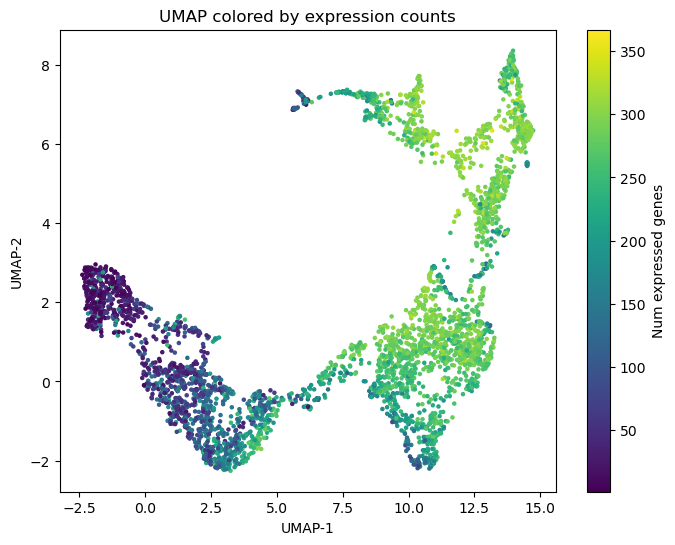

In [18]:
import matplotlib.pyplot as plt

# Example: color by number of expressed genes
expr_counts = np.array([np.count_nonzero(e[3]) for e in metadata])

plt.figure(figsize=(8, 6))
plt.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=expr_counts, cmap="viridis", s=5)
plt.colorbar(label="Num expressed genes")
plt.title("UMAP colored by expression counts")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.show()
